In [1]:
import os
os.environ['KERAS_BACKEND']='tensorflow' # can choose theano, tensorflow, cntk 
os.environ['THEANO_FLAGS']='floatX=float32,device=cuda,optimizer=fast_run,dnn.library_path=/usr/lib'
#os.environ['THEANO_FLAGS']='floatX=float32,device=cuda,optimizer=fast_compile,dnn.library_path=/usr/lib'

In [2]:
import keras.backend as K
if os.environ['KERAS_BACKEND'] =='theano':
    channel_axis=1
    K.set_image_data_format('channels_first')
    channel_first = True
else:
    K.set_image_data_format('channels_last')
    channel_axis=-1
    channel_first = False

/home/k123/env/python2.7.12/local/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [3]:
from keras.models import Sequential, Model
from keras.layers import Conv2D, ZeroPadding2D, BatchNormalization, Input, Dropout
from keras.layers import Conv2DTranspose, Reshape, Activation, Cropping2D, Flatten
from keras.layers import Concatenate
from keras.layers.advanced_activations import LeakyReLU
from keras.activations import relu
from keras.initializers import RandomNormal

In [4]:
# Weights initializations
# bias are initailized as 0
def __conv_init(a):
    print("conv_init", a)
    k = RandomNormal(0, 0.02)(a) # for convolution kernel
    k.conv_weight = True    
    return k
conv_init = RandomNormal(0, 0.02)
gamma_init = RandomNormal(1., 0.02) # for batch normalization



In [5]:
# HACK speed up theano
if K._BACKEND == 'theano':
    import keras.backend.theano_backend as theano_backend
    def _preprocess_conv2d_kernel(kernel, data_format):
        #return kernel
        if hasattr(kernel, "original"):
            print("use original")
            return kernel.original
        elif hasattr(kernel, '_keras_shape'):
            s = kernel._keras_shape
            print("use reshape",s)
            kernel = kernel.reshape((s[3], s[2],s[0], s[1]))
        else:
            kernel = kernel.dimshuffle((3, 2, 0, 1))
        return kernel
    theano_backend._preprocess_conv2d_kernel = _preprocess_conv2d_kernel

In [6]:
# Basic discriminator
def conv2d(f, *a, **k):
    return Conv2D(f, kernel_initializer = conv_init, *a, **k)
def batchnorm():
    return BatchNormalization(momentum=0.9, axis=channel_axis, epsilon=1.01e-5,
                                   gamma_initializer = gamma_init)
def BASIC_D(nc_in, ndf, max_layers=3, use_sigmoid=True):
    """DCGAN_D(nc, ndf, max_layers=3)
       nc: channels
       ndf: filters of the first layer
       max_layers: max hidden layers
    """    
    if channel_first:
        input_a =  Input(shape=(nc_in, None, None))
    else:
#         input_a = Input(shape=(None, None, nc_in))
        input_a = Input(shape=(256, 256, nc_in))
    _ = input_a
    _ = conv2d(ndf, kernel_size=4, strides=2, padding="same", name = 'First') (_)
    _ = LeakyReLU(alpha=0.2)(_)
    
    for layer in range(1, max_layers):        
        out_feat = ndf * min(2**layer, 8)
        _ = conv2d(out_feat, kernel_size=4, strides=2, padding="same", 
                   use_bias=False, name = 'pyramid.{0}'.format(layer)             
                        ) (_)
        _ = batchnorm()(_, training=1)        
        _ = LeakyReLU(alpha=0.2)(_)
    
    out_feat = ndf*min(2**max_layers, 8)
    _ = ZeroPadding2D(1)(_)
    _ = conv2d(out_feat, kernel_size=4,  use_bias=False, name = 'pyramid_last') (_)
    _ = batchnorm()(_, training=1)
    _ = LeakyReLU(alpha=0.2)(_)
    
    # final layer
    _ = ZeroPadding2D(1)(_)
    _ = conv2d(1, kernel_size=4, name = 'final'.format(out_feat, 1), 
               activation = "sigmoid" if use_sigmoid else None) (_)    
    return Model(inputs=[input_a], outputs=_)

In [7]:
def UNET_G(isize, nc_in=3, nc_out=3, ngf=64, fixed_input_size=True):    
    max_nf = 8*ngf    
    def block(x, s, nf_in, use_batchnorm=True, nf_out=None, nf_next=None):
        # print("block",x,s,nf_in, use_batchnorm, nf_out, nf_next)
        assert s>=2 and s%2==0
        if nf_next is None:
            nf_next = min(nf_in*2, max_nf)
        if nf_out is None:
            nf_out = nf_in
        x = conv2d(nf_next, kernel_size=4, strides=2, use_bias=(not (use_batchnorm and s>2)),
                   padding="same", name = 'conv_{0}'.format(s)) (x)
        if s>2:
            if use_batchnorm:
                x = batchnorm()(x, training=1)
            x2 = LeakyReLU(alpha=0.2)(x)
            x2 = block(x2, s//2, nf_next)
            x = Concatenate(axis=channel_axis)([x, x2])            
        x = Activation("relu")(x)
        x = Conv2DTranspose(nf_out, kernel_size=4, strides=2, use_bias=not use_batchnorm,
                            kernel_initializer = conv_init,          
                            name = 'convt.{0}'.format(s))(x)        
        x = Cropping2D(1)(x)
        if use_batchnorm:
            x = batchnorm()(x, training=1)
        if s <=8:
            x = Dropout(0.5)(x, training=1)
        return x
    
    s = isize if fixed_input_size else None
    if channel_first:
        _ = inputs = Input(shape=(nc_in, s, s))
    else:
        _ = inputs = Input(shape=(s, s, nc_in))        
    _ = block(_, isize, nc_in, False, nf_out=nc_out, nf_next=ngf)
    _ = Activation('tanh')(_)
    return Model(inputs=inputs, outputs=[_])

In [8]:
nc_in = 3
nc_out = 3
ngf = 64
ndf = 64
use_lsgan = True
lambda_ = 10 if use_lsgan else 100
# lambda_ = 1 if use_lsgan else 10 # for face2emoji 

loadSize = 143
imageSize = 128
batchSize = 1
lrD = 2e-4
lrG = 2e-4

In [9]:
netDA = BASIC_D(nc_in, ndf, use_sigmoid = not use_lsgan)
netDB = BASIC_D(nc_out, ndf, use_sigmoid = not use_lsgan)
netDA.summary()
# netDB.summary()


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 256, 256, 3)       0         
_________________________________________________________________
First (Conv2D)               (None, 128, 128, 64)      3136      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 128, 128, 64)      0         
_________________________________________________________________
pyramid.1 (Conv2D)           (None, 64, 64, 128)       131072    
_________________________________________________________________
batch_normalization_1 (Batch (None, 64, 64, 128)       512       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 64, 64, 128)       0         
_________________________________________________________________
pyramid.2 (Conv2D)           (None, 32, 32, 256)       524288    
__________

In [10]:
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot


netGB = UNET_G(imageSize, nc_in, nc_out, ngf)
netGA = UNET_G(imageSize, nc_out, nc_in, ngf)
#SVG(model_to_dot(netG, show_shapes=True).create(prog='dot', format='svg'))
netGA.summary()



__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
conv_128 (Conv2D)               (None, 64, 64, 64)   3136        input_4[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_15 (LeakyReLU)      (None, 64, 64, 64)   0           conv_128[0][0]                   
__________________________________________________________________________________________________
conv_64 (Conv2D)                (None, 32, 32, 128)  131072      leaky_re_lu_15[0][0]             
__________________________________________________________________________________________________
batch_norm

In [11]:
from keras.optimizers import RMSprop, SGD, Adam
if use_lsgan:
    loss_fn = lambda output, target : K.mean(K.abs(K.square(output-target)))
else:
    loss_fn = lambda output, target : -K.mean(K.log(output+1e-12)*target+K.log(1-output+1e-12)*(1-target))

def cycle_variables(netG1, netG2):
    real_input = netG1.inputs[0]
    fake_output = netG1.outputs[0]
    rec_input = netG2([fake_output])
    fn_generate = K.function([real_input], [fake_output, rec_input])
    return real_input, fake_output, rec_input, fn_generate

real_A, fake_B, rec_A, cycleA_generate = cycle_variables(netGB, netGA)
real_B, fake_A, rec_B, cycleB_generate = cycle_variables(netGA, netGB)

In [12]:
def D_loss(netD, real, fake, rec):
    output_real = netD([real])
    output_fake = netD([fake])
    loss_D_real = loss_fn(output_real, K.ones_like(output_real))
    loss_D_fake = loss_fn(output_fake, K.zeros_like(output_fake))
    loss_G = loss_fn(output_fake, K.ones_like(output_fake))
    loss_D = loss_D_real+loss_D_fake
    loss_cyc = K.mean(K.abs(rec-real))
    return loss_D, loss_G, loss_cyc

loss_DA, loss_GA, loss_cycA = D_loss(netDA, real_A, fake_A, rec_A)
loss_DB, loss_GB, loss_cycB = D_loss(netDB, real_B, fake_B, rec_B)
loss_cyc = loss_cycA+loss_cycB

In [13]:
loss_G = loss_GA+loss_GB+lambda_*loss_cyc
loss_D = loss_DA+loss_DB

weightsD = netDA.trainable_weights + netDB.trainable_weights
weightsG = netGA.trainable_weights + netGB.trainable_weights

training_updates = Adam(lr=lrD, beta_1=0.5).get_updates(weightsD,[],loss_D)
netD_train = K.function([real_A, real_B],[loss_DA/2, loss_DB/2], training_updates)
training_updates = Adam(lr=lrG, beta_1=0.5).get_updates(weightsG,[], loss_G)
netG_train = K.function([real_A, real_B], [loss_GA, loss_GB, loss_cyc], training_updates)

In [16]:
from PIL import Image
import numpy as np
import glob
from random import randint, shuffle

def load_data(file_pattern):
    return glob.glob(file_pattern)

def read_image(fn):
#     load image with BILINEAR resizing, and crop the central region. 143*143 -> 128*128
    im = Image.open(fn).convert('RGB')
    im = im.resize( (loadSize, loadSize), Image.BILINEAR )
#     normalize,[0,255] -> [-1,1]
    arr = np.array(im)/255. * 2 -1
#     print 'im',im
#     print arr
    w1,w2 = (loadSize-imageSize)//2,(loadSize+imageSize)//2
    h1,h2 = w1,w2
    img = arr[h1:h2, w1:w2, :]
#     horizontal flip
    if randint(0,1):
        img=img[:,::-1]
    if channel_first:        
        img = np.moveaxis(img, 2, 0)
    return img

#data = "edges2shoes"
# dataset = "horse2zebra"
dataset = "face2emoji"
train_A = load_data('CycleGAN/{}/trainA/*.jpg'.format(dataset))
train_B = load_data('CycleGAN/{}/trainB/*.jpg'.format(dataset))
assert len(train_A) and len(train_B)

In [17]:
def minibatch(data, batchsize):
    length = len(data)
    epoch = i = 0
    tmpsize = None    
    shuffle(data)
    while True:
        size = tmpsize if tmpsize else batchsize
        if i+size > length:
            shuffle(data)
            i = 0
            epoch+=1        
        rtn = [read_image(data[j]) for j in range(i,i+size)]
        i+=size
        tmpsize = yield epoch, np.float32(rtn)       

def minibatchAB(dataA, dataB, batchsize):
    batchA=minibatch(dataA, batchsize)
    batchB=minibatch(dataB, batchsize)
    tmpsize = None    
    while True:        
        ep1, A = batchA.send(tmpsize)
        ep2, B = batchB.send(tmpsize)
        tmpsize = yield max(ep1, ep2), A, B

(6, 128, 128, 3)


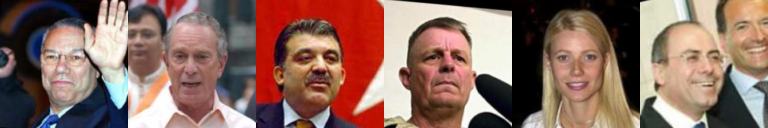

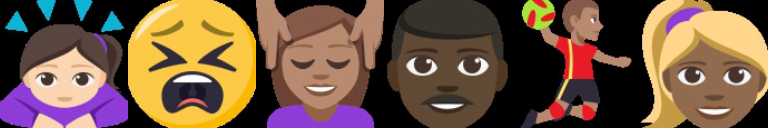

In [18]:
from IPython.display import display
# import matplotlib.pyplot as plt
def showX(X, rows=1):
    assert X.shape[0]%rows == 0
    int_X = ( (X+1)/2*255).clip(0,255).astype('uint8')
    if channel_first:
        int_X = np.moveaxis(int_X.reshape(-1,3,imageSize,imageSize), 1, 3)
    else:
        int_X = int_X.reshape(-1,imageSize,imageSize, 3)
    int_X = int_X.reshape(rows, -1, imageSize, imageSize,3).swapaxes(1,2).reshape(rows*imageSize,-1, 3)
#     
#     im = im.resize( (loadSize, loadSize), Image.BILINEAR )
    display(Image.fromarray(int_X))
#     plt.imshow(int_X,aspect='auto')
#     plt.imshow(int_X)
#     plt.show()
train_batch = minibatchAB(train_A, train_B, 6)
_, A, B = next(train_batch)
print A.shape
# print A
showX(A)
showX(B)
del train_batch, A, B

In [19]:
def showG(A,B):
    assert A.shape==B.shape
    def G(fn_generate, X):
        r = np.array([fn_generate([X[i:i+1]]) for i in range(X.shape[0])])
        return r.swapaxes(0,1)[:,:,0]        
    rA = G(cycleA_generate, A)
    rB = G(cycleB_generate, B)
    arr = np.concatenate([A,B,rA[0],rB[0],rA[1],rB[1]])
    showX(arr, 3)

In [20]:
from keras.models import save_model
from os.path import join
import os

def save(dataset_name):
    # save models
    
    dir_path = join('./','models',dataset_name)
    if not os.path.isdir(join('./','models')):
        os.mkdir(join('./','models'))
    if not os.path.isdir(dir_path):
        os.mkdir(dir_path)

    save_model(netDA, join(dir_path,'netDA.hdf5'))
    save_model(netDB, join(dir_path,'netDB.hdf5'))
    save_model(netGA, join(dir_path,'netGA.hdf5'))
    save_model(netGB, join(dir_path,'netGB.hdf5'))

def load(dataset_name):
    # load model
    
    print 'load model from %s' % dataset_name
    
    dir_path = join('./','models',dataset_name)
    
    netDA.load_weights(join(dir_path,'netDA.hdf5'))
    netDB.load_weights(join(dir_path,'netDB.hdf5'))
    netGA.load_weights(join(dir_path,'netGA.hdf5'))
    netGB.load_weights(join(dir_path,'netGB.hdf5'))








load model from face2emoji
start training model with dataset : face2emoji
[0/350][50] Loss_D: 0.100013 0.009936 Loss_G: 0.838292 1.003258 loss_cyc 0.110788, save model, time consume : 28.38


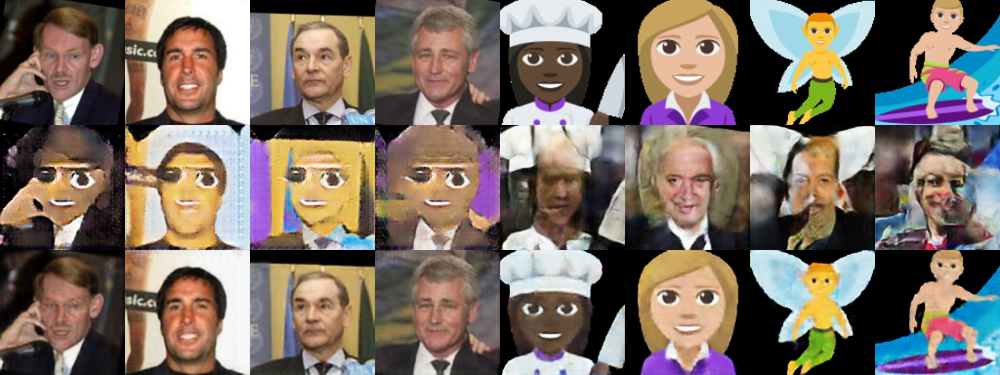

[0/350][100] Loss_D: 0.109070 0.009088 Loss_G: 0.832931 1.002405 loss_cyc 0.105482, save model, time consume : 53.63


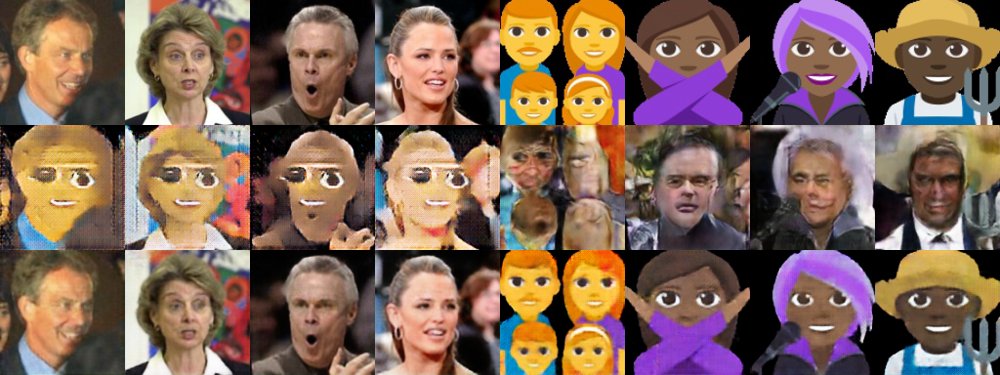

[0/350][150] Loss_D: 0.113246 0.004087 Loss_G: 0.812167 1.007736 loss_cyc 0.106163, save model, time consume : 75.49


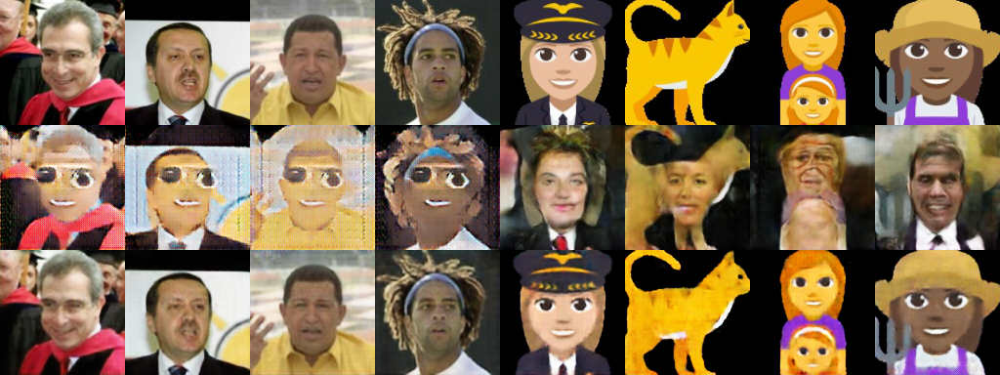

[0/350][200] Loss_D: 0.100010 0.006575 Loss_G: 0.816630 0.993118 loss_cyc 0.107164, save model, time consume : 97.34


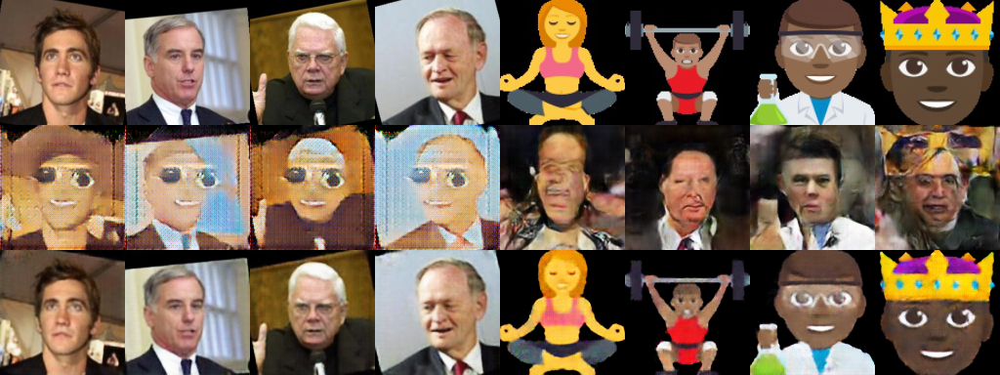

[0/350][250] Loss_D: 0.105268 0.002554 Loss_G: 0.837370 1.004047 loss_cyc 0.096370, save model, time consume : 119.28


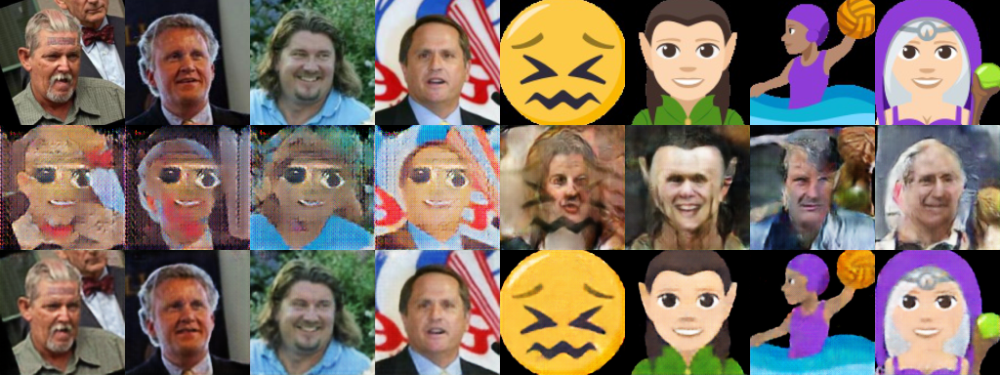

[0/350][300] Loss_D: 0.113565 0.001498 Loss_G: 0.783006 0.997559 loss_cyc 0.096014, save model, time consume : 141.03


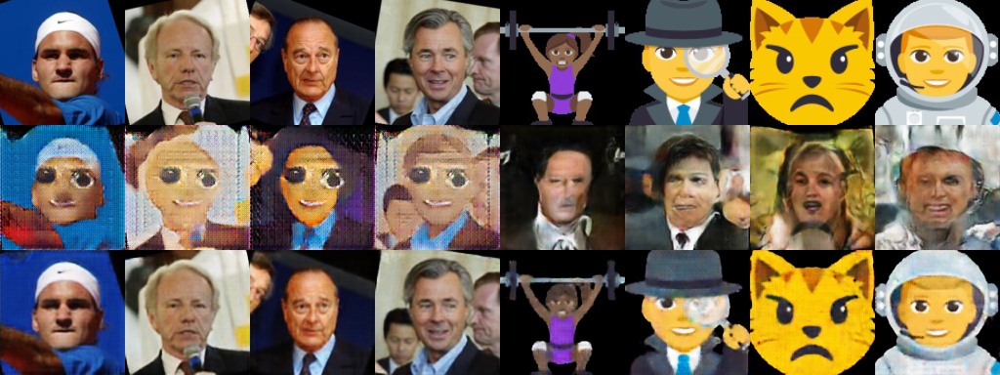

[0/350][350] Loss_D: 0.121120 0.001364 Loss_G: 0.813783 0.997481 loss_cyc 0.099262, save model, time consume : 162.70


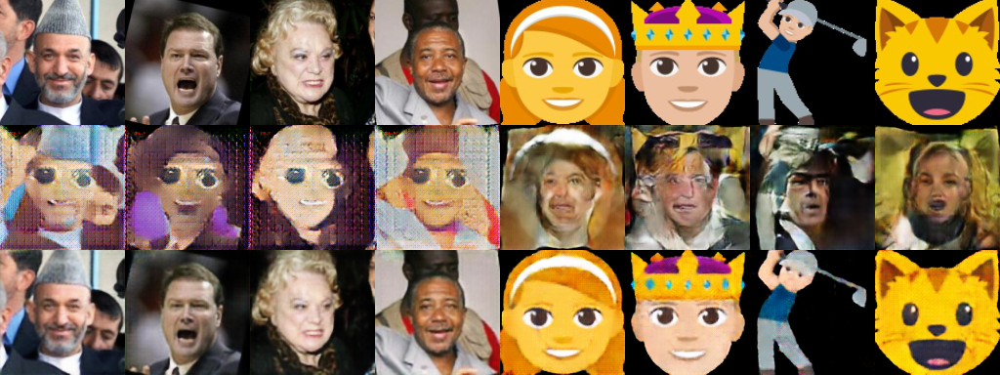

[0/350][400] Loss_D: 0.113780 0.001010 Loss_G: 0.797083 1.000526 loss_cyc 0.100467, save model, time consume : 184.39


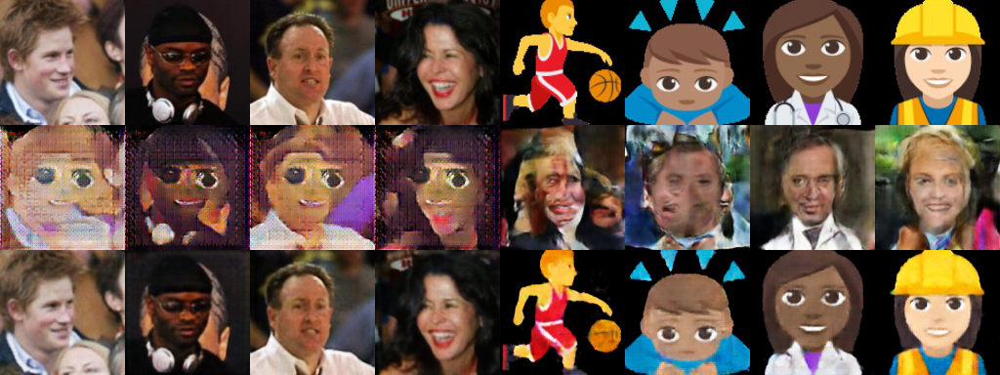

[0/350][450] Loss_D: 0.098189 0.000930 Loss_G: 0.837322 0.998624 loss_cyc 0.097732, save model, time consume : 206.11


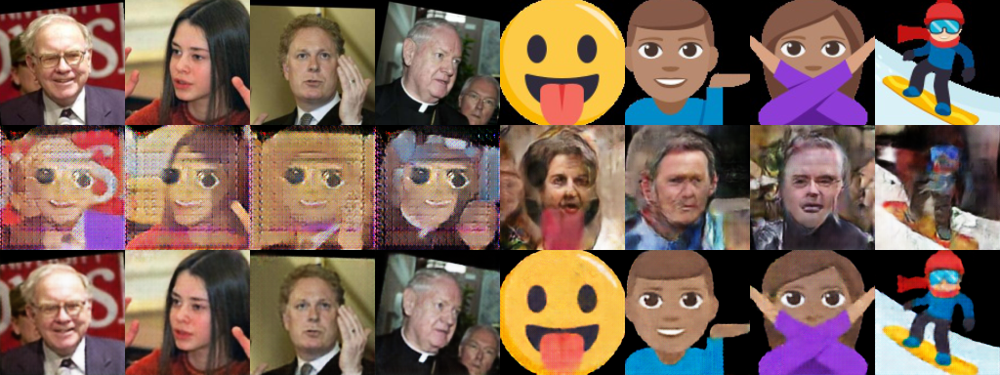

[0/350][500] Loss_D: 0.103297 0.004335 Loss_G: 0.816528 1.005918 loss_cyc 0.097424, save model, time consume : 227.88


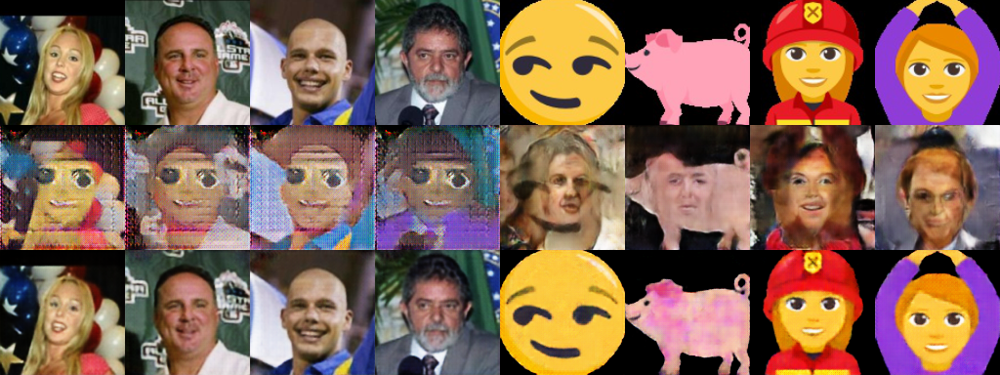

[0/350][550] Loss_D: 0.111731 0.010887 Loss_G: 0.843178 1.009599 loss_cyc 0.104298, save model, time consume : 249.58


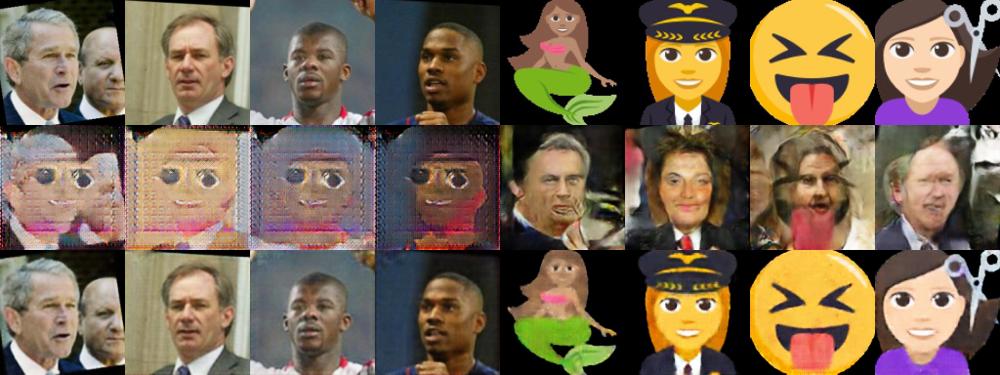

[0/350][600] Loss_D: 0.127387 0.007444 Loss_G: 0.795375 0.998313 loss_cyc 0.100725, save model, time consume : 271.32


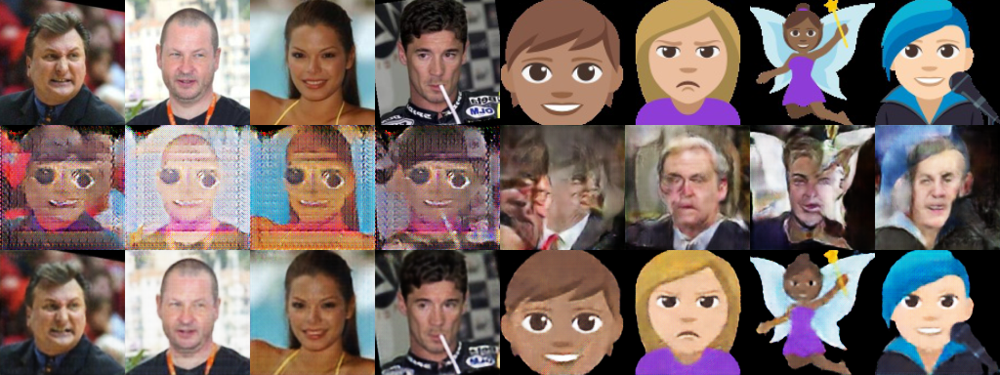

[0/350][650] Loss_D: 0.113878 0.001369 Loss_G: 0.825622 0.998598 loss_cyc 0.100165, save model, time consume : 293.03


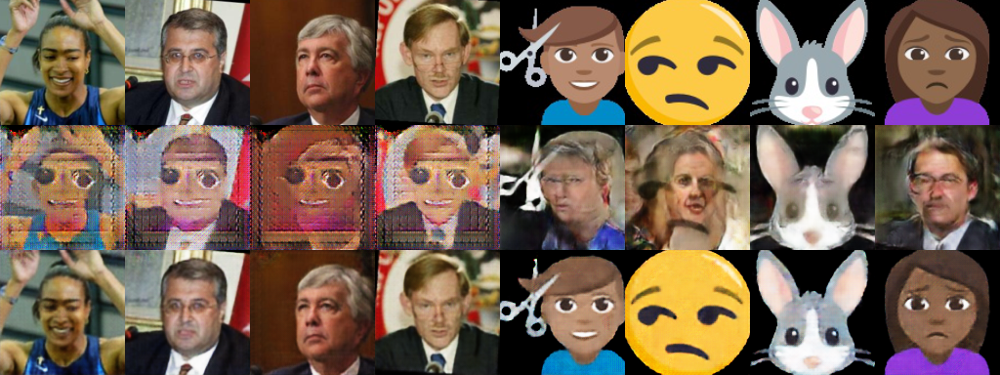

[0/350][700] Loss_D: 0.111863 0.001625 Loss_G: 0.781461 0.992254 loss_cyc 0.100386, save model, time consume : 314.74


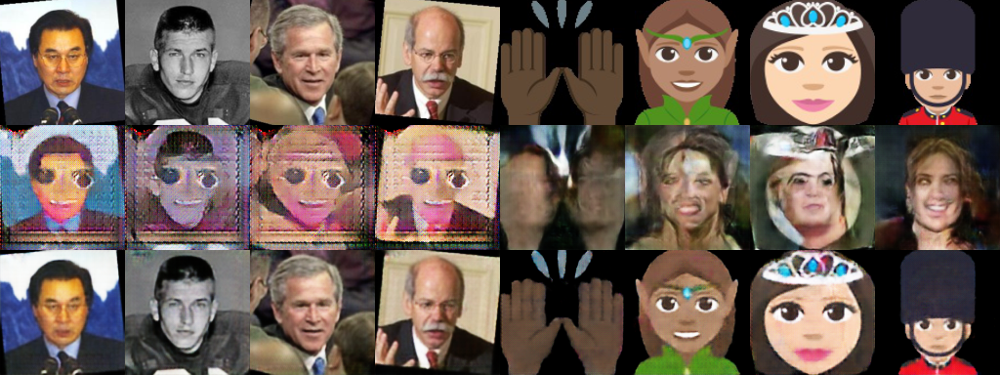

[0/350][750] Loss_D: 0.102860 0.004711 Loss_G: 0.788002 1.027140 loss_cyc 0.103884, save model, time consume : 336.46


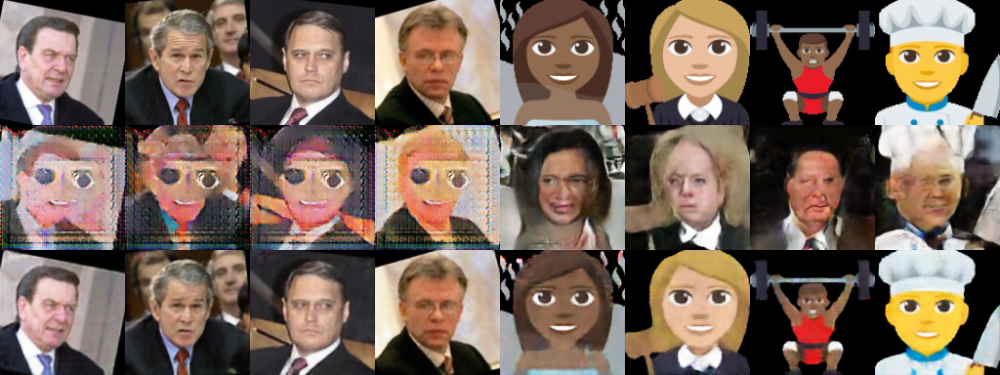

[0/350][800] Loss_D: 0.110184 0.001200 Loss_G: 0.799978 0.998394 loss_cyc 0.099451, save model, time consume : 358.22


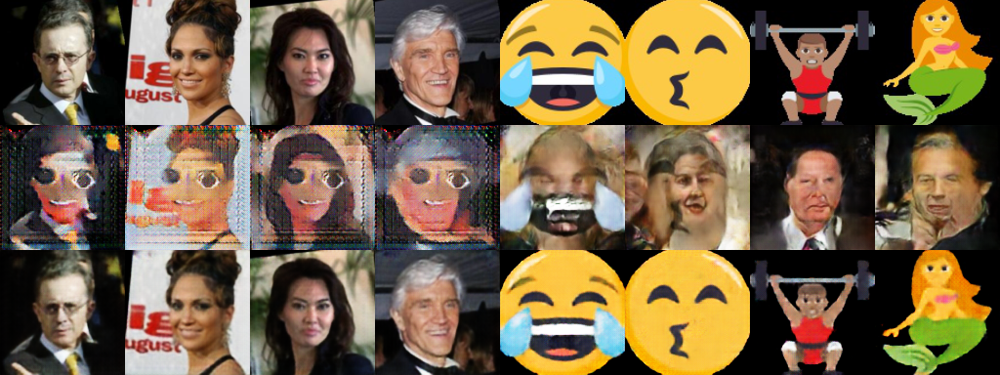

[0/350][850] Loss_D: 0.116364 0.000940 Loss_G: 0.814214 0.998803 loss_cyc 0.104315, save model, time consume : 379.95


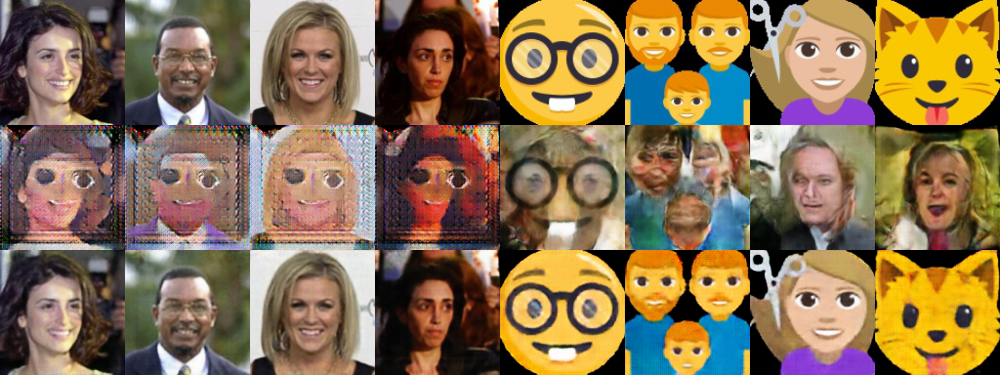

[0/350][900] Loss_D: 0.117147 0.000789 Loss_G: 0.811485 0.996855 loss_cyc 0.098504, save model, time consume : 401.71


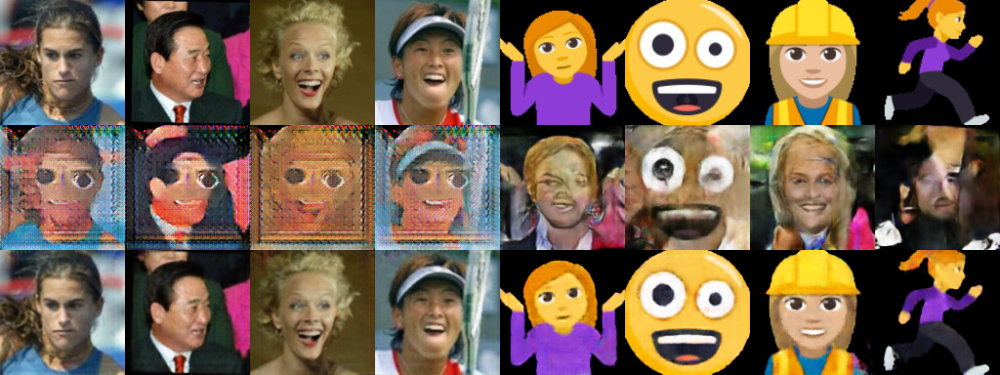

[1/350][950] Loss_D: 0.104430 0.000978 Loss_G: 0.809816 0.999342 loss_cyc 0.115866, save model, time consume : 423.44


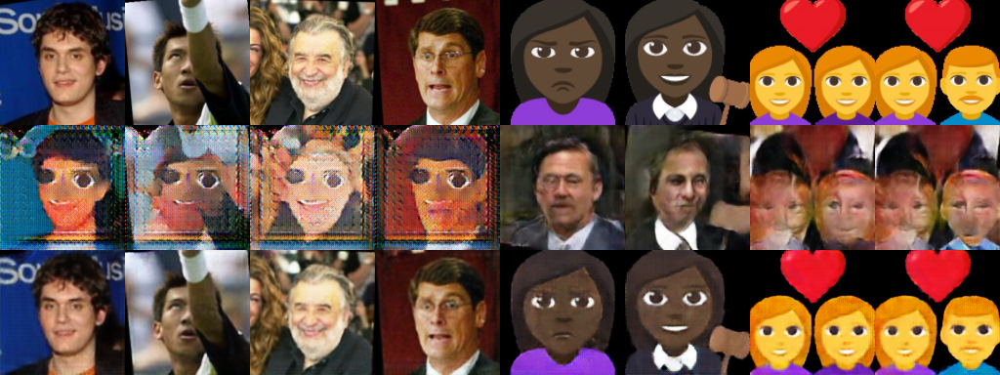

[1/350][1000] Loss_D: 0.104032 0.001115 Loss_G: 0.803225 1.000490 loss_cyc 0.105480, save model, time consume : 446.14


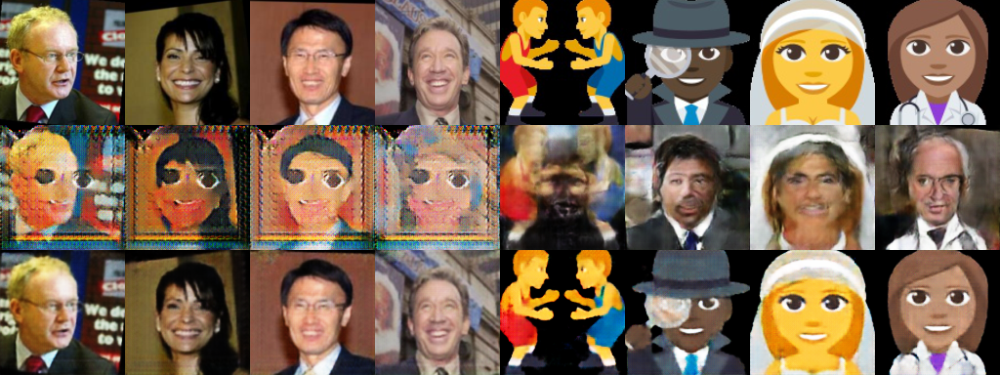

[1/350][1050] Loss_D: 0.110293 0.002982 Loss_G: 0.834726 1.006343 loss_cyc 0.105136, save model, time consume : 467.88


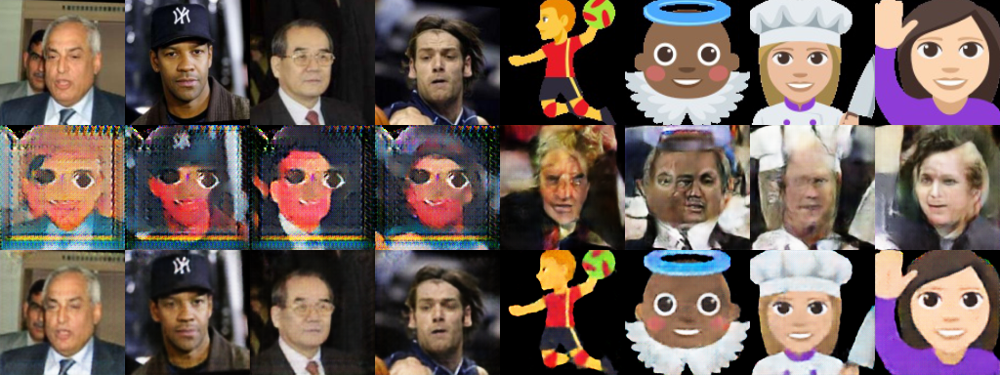

[1/350][1100] Loss_D: 0.113841 0.001357 Loss_G: 0.804988 0.999921 loss_cyc 0.103256, save model, time consume : 489.61


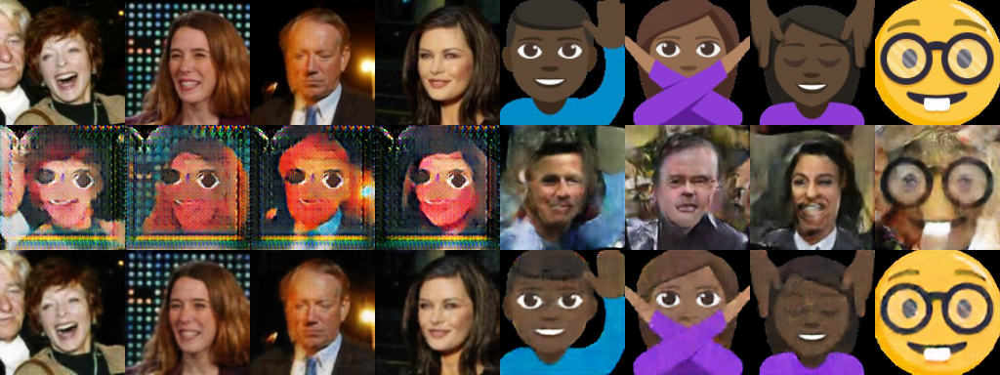

[1/350][1150] Loss_D: 0.118997 0.001186 Loss_G: 0.804083 1.000612 loss_cyc 0.099709, save model, time consume : 511.36


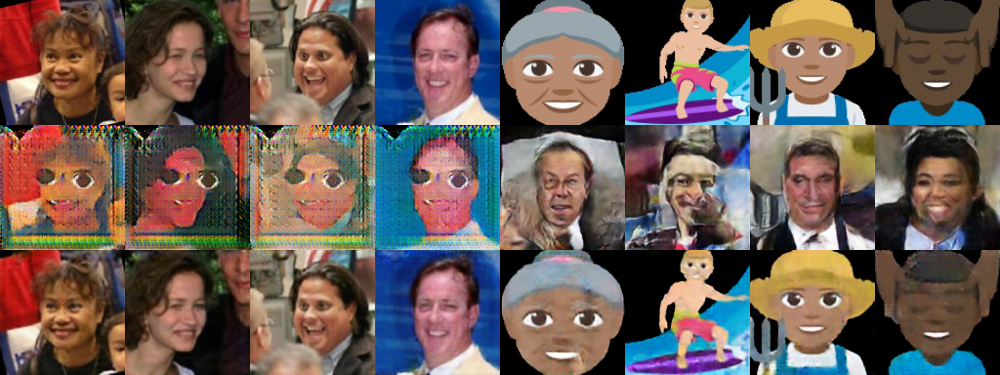

[1/350][1200] Loss_D: 0.103602 0.000918 Loss_G: 0.806461 0.997375 loss_cyc 0.102739, save model, time consume : 533.11


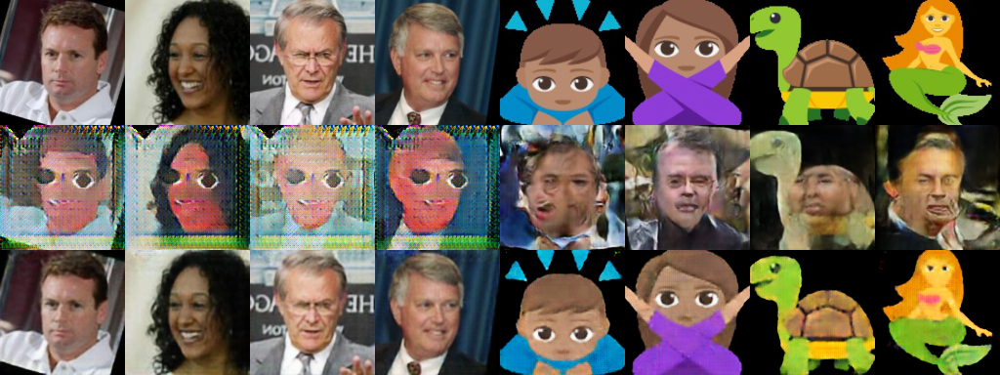

[1/350][1250] Loss_D: 0.102074 0.001081 Loss_G: 0.884850 1.000180 loss_cyc 0.131924, save model, time consume : 554.86


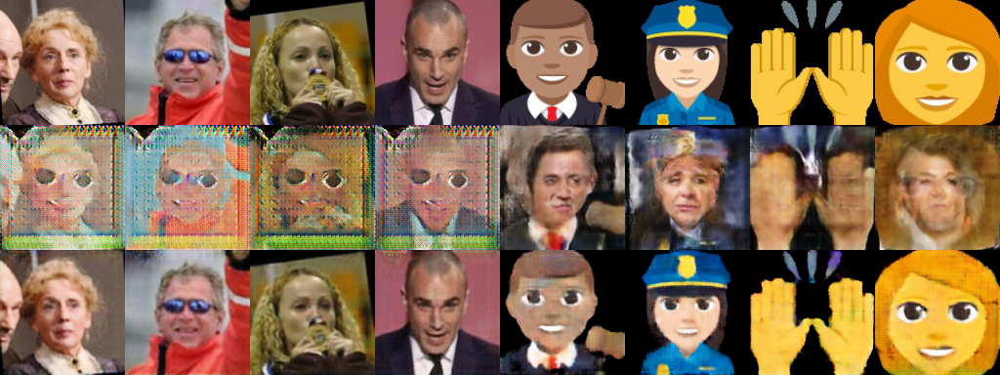

[1/350][1300] Loss_D: 0.069498 0.000725 Loss_G: 0.935175 0.998449 loss_cyc 0.121100, save model, time consume : 576.58


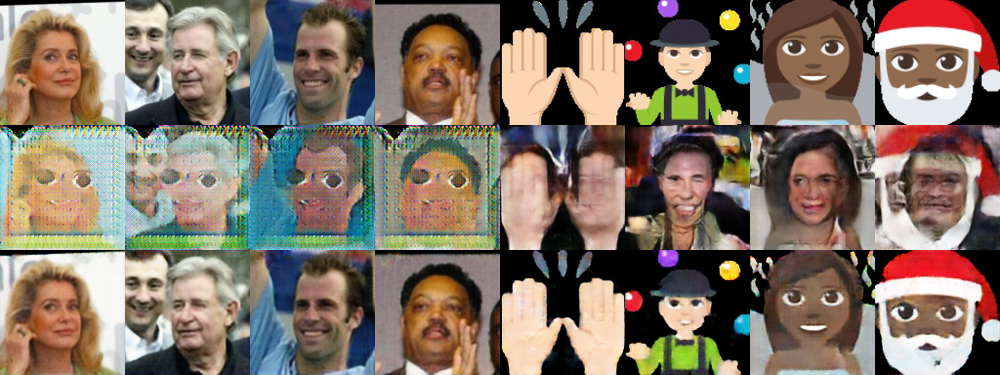

[1/350][1350] Loss_D: 0.073741 0.000789 Loss_G: 0.857225 0.998017 loss_cyc 0.115579, save model, time consume : 598.33


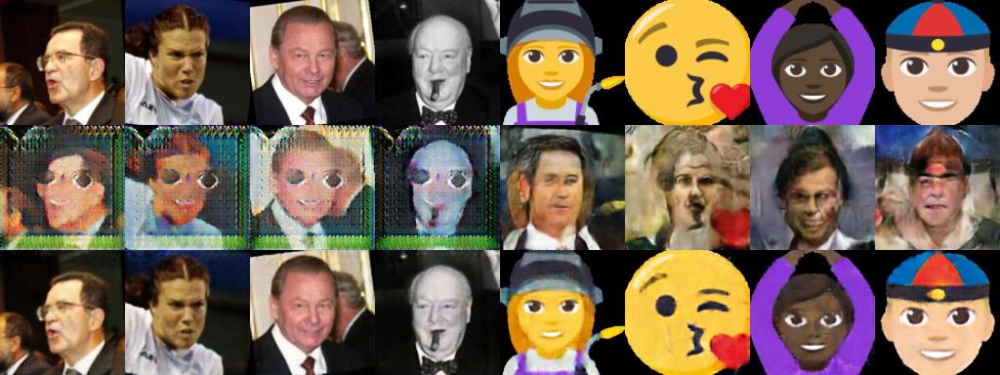

[1/350][1400] Loss_D: 0.094785 0.000675 Loss_G: 0.821094 0.998176 loss_cyc 0.120364, save model, time consume : 620.05


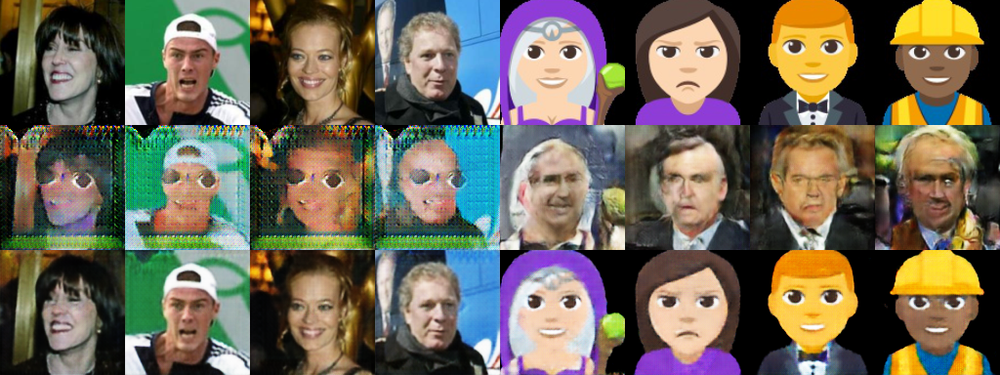

[1/350][1450] Loss_D: 0.086868 0.000984 Loss_G: 0.838772 1.000103 loss_cyc 0.104838, save model, time consume : 641.78


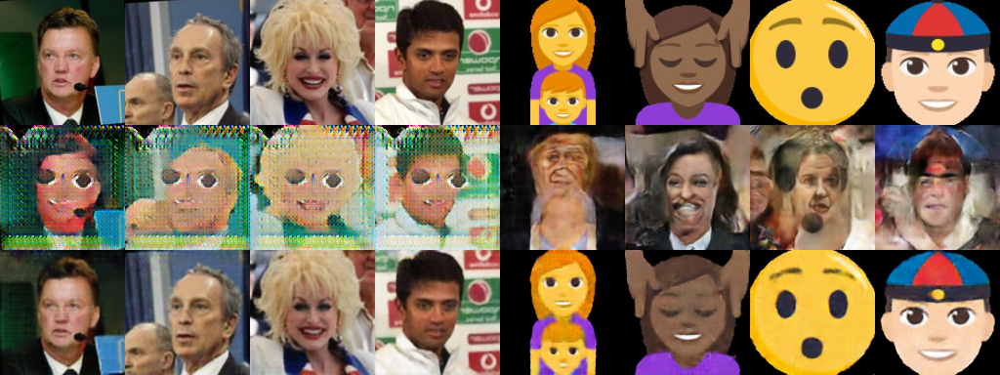

[1/350][1500] Loss_D: 0.115102 0.001008 Loss_G: 0.822017 0.996684 loss_cyc 0.103326, save model, time consume : 663.52


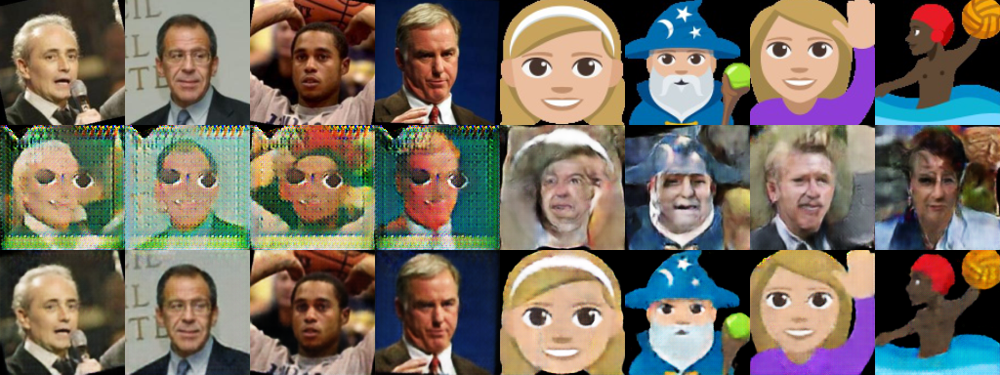

[1/350][1550] Loss_D: 0.110160 0.000864 Loss_G: 0.835671 1.003705 loss_cyc 0.102234, save model, time consume : 685.26


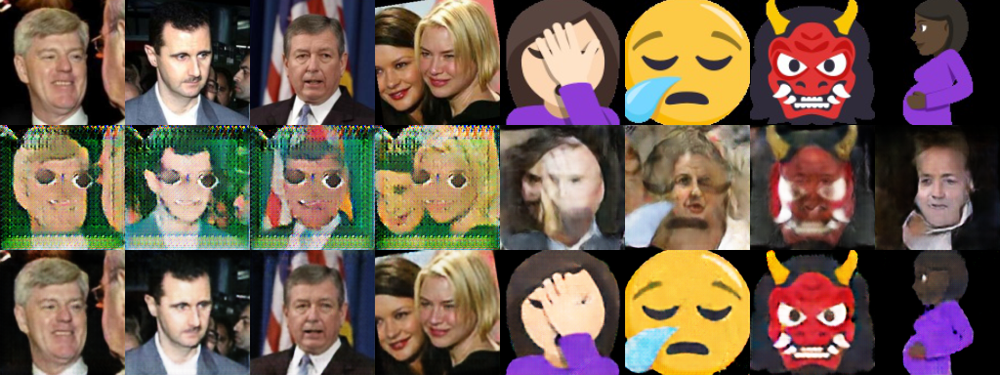

[1/350][1600] Loss_D: 0.137379 0.001827 Loss_G: 0.770526 1.002640 loss_cyc 0.100482, save model, time consume : 707.10


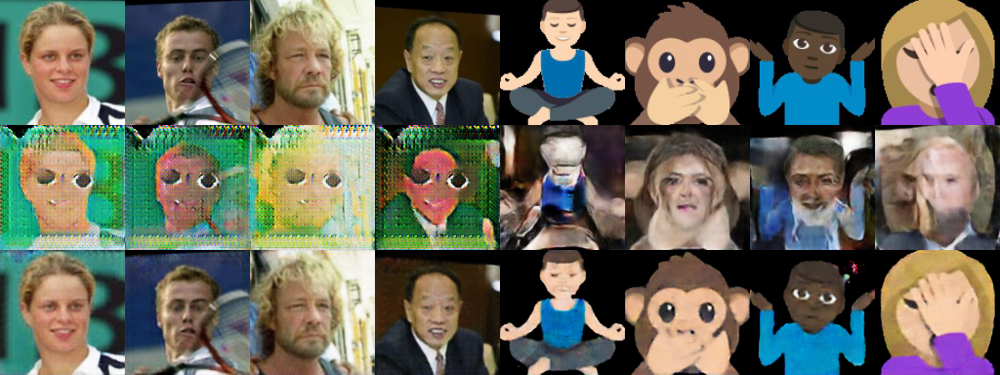

[1/350][1650] Loss_D: 0.083001 0.001585 Loss_G: 0.822785 1.003589 loss_cyc 0.113891, save model, time consume : 728.83


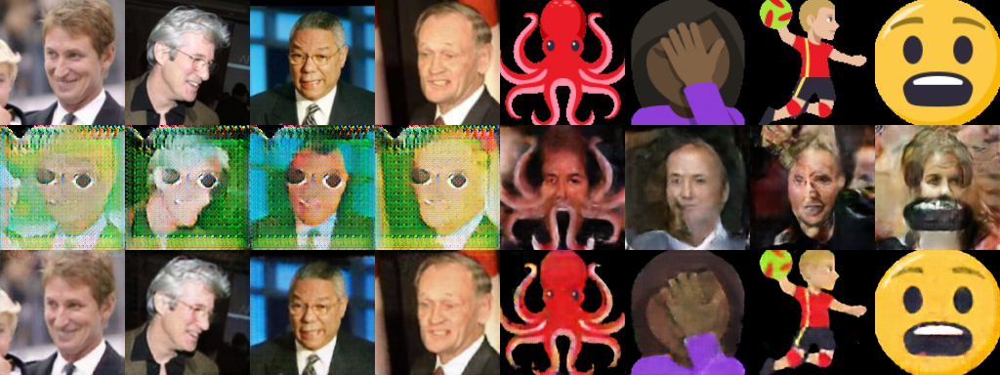

[1/350][1700] Loss_D: 0.105243 0.000997 Loss_G: 0.831635 0.997131 loss_cyc 0.103873, save model, time consume : 750.59


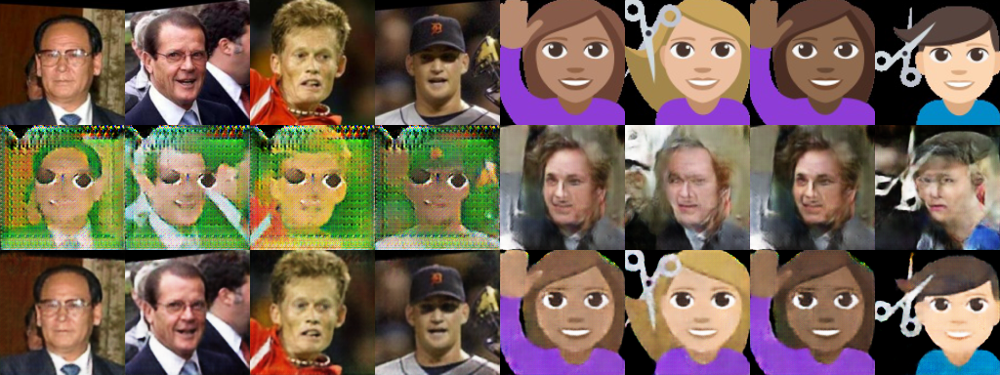

[1/350][1750] Loss_D: 0.120058 0.001052 Loss_G: 0.808728 1.003483 loss_cyc 0.101711, save model, time consume : 772.59


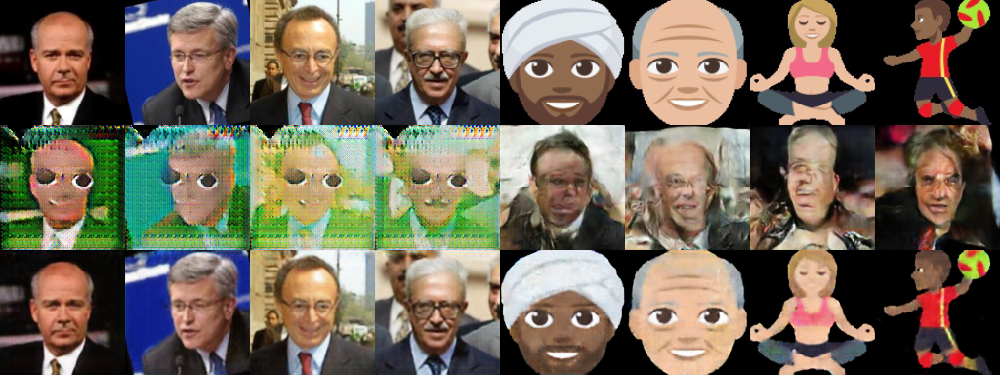

[1/350][1800] Loss_D: 0.125778 0.001066 Loss_G: 0.775606 0.997232 loss_cyc 0.102345, save model, time consume : 794.36


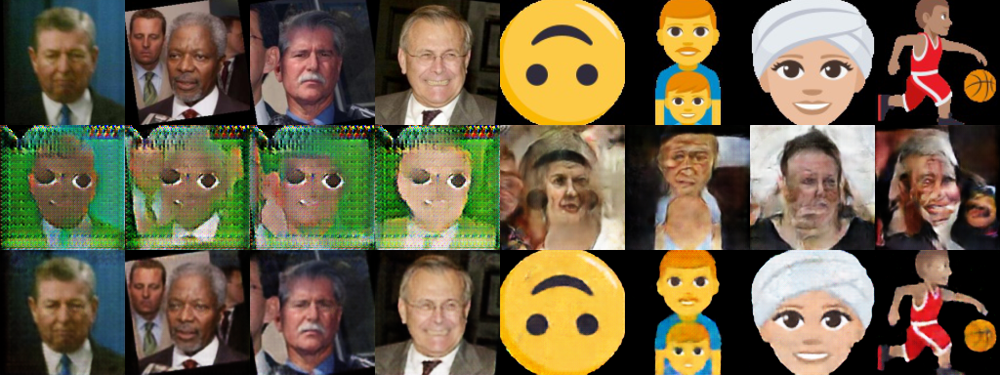

[1/350][1850] Loss_D: 0.106585 0.000658 Loss_G: 0.803725 1.000432 loss_cyc 0.095911, save model, time consume : 816.12


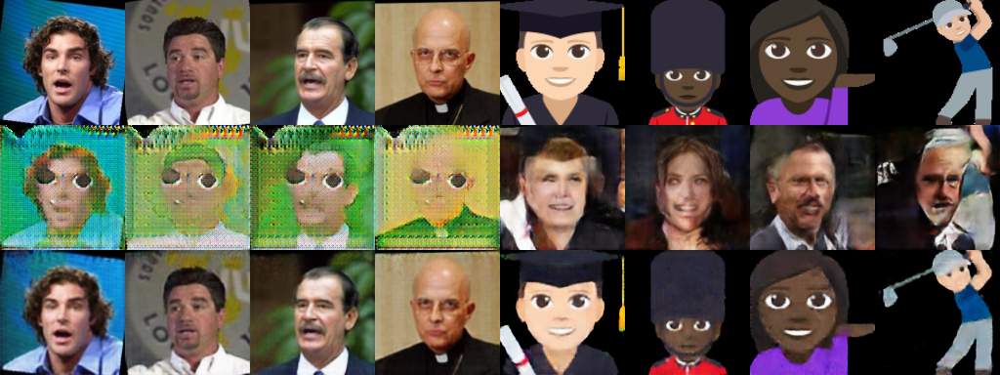

In [ ]:
import time
import os
from IPython.display import clear_output
t0 = time.time()
niter = 350
gen_iterations = 0
epoch = 0
errCyc_sum = errGA_sum = errGB_sum = errDA_sum = errDB_sum = 0

display_iters = 50
#val_batch = minibatch(valAB, 6, direction)
train_batch = minibatchAB(train_A, train_B, batchSize)
load(dataset)
with open('./log','w') as f:
    f.write('start training model with dataset : %s' % dataset)
print 'start training model with dataset : %s' % dataset
while epoch < niter: 
    epoch, A, B = next(train_batch)        
    errDA, errDB  = netD_train([A, B])
    errDA_sum +=errDA
    errDB_sum +=errDB

    # epoch, trainA, trainB = next(train_batch)
    errGA, errGB, errCyc = netG_train([A, B])
    errGA_sum += errGA
    errGB_sum += errGB
    errCyc_sum += errCyc
    gen_iterations+=1
    if gen_iterations%display_iters==0:
#         clear_output()
        print('[%d/%d][%d] Loss_D: %f %f Loss_G: %f %f loss_cyc %f, save model, time consume : %.2f'
        % (epoch, niter, gen_iterations, errDA_sum/display_iters, errDB_sum/display_iters,
           errGA_sum/display_iters, errGB_sum/display_iters, 
           errCyc_sum/display_iters, time.time()-t0) )
        _, A, B = train_batch.send(4)
        save(dataset)
        showG(A,B)        
        log = '[%d/%d][%d] Loss_D: %f %f Loss_G: %f %f loss_cyc %f, save model, time consume : %.2f\n' % (epoch, niter, gen_iterations, errDA_sum/display_iters, errDB_sum/display_iters, errGA_sum/display_iters, errGB_sum/display_iters, \
           errCyc_sum/display_iters, time.time()-t0) 
            
        errCyc_sum = errGA_sum = errGB_sum = errDA_sum = errDB_sum = 0
        with open('./log','a') as f:
            f.write(log)
            